In [1]:
# Import the libraries required for exploration and preproccesing
import numpy as np
import pandas as pd

from IPython.display import display, HTML
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.io as pio


import seaborn as sns
from importlib import reload
import matplotlib.pyplot as plt
import matplotlib
import warnings
matplotlib.rcParams['figure.facecolor'] = 'white'
matplotlib.rcParams['axes.facecolor'] = 'white'

matplotlib.rcParams['figure.facecolor'] = 'white'
matplotlib.rcParams['axes.facecolor'] = 'white'

# Configure Jupyter Notebook
pd.set_option('display.max_columns', None) 
pd.set_option('display.max_rows', 500) 
pd.set_option('display.expand_frame_repr', False)
# pd.set_option('max_colwidth', -1)
display(HTML("<style>div.output_scroll { height: 35em; }</style>"))

reload(plt)
%matplotlib inline
%config InlineBackend.figure_format ='retina'

warnings.filterwarnings('ignore')

# configure plotly graph objects
pio.renderers.default = 'iframe'
# pio.renderers.default = 'vscode'

pio.templates["ck_template"] = go.layout.Template(
    layout_colorway = px.colors.sequential.Viridis, 
#     layout_hovermode = 'closest',
#     layout_hoverdistance = -1,
    layout_autosize=False,
    layout_width=800,
    layout_height=600,
    layout_font = dict(family="Calibri Light"),
    layout_title_font = dict(family="Calibri"),
    layout_hoverlabel_font = dict(family="Calibri Light"),
#     plot_bgcolor="white",
)
 
# pio.templates.default = 'seaborn+ck_template+gridon'
pio.templates.default = 'ck_template+gridon'
# pio.templates.default = 'seaborn+gridon'
# pio.templates

In [2]:
# Give names to the features
index_names = ['engine', 'cycle']
setting_names = ['setting_1', 'setting_2', 'setting_3']
sensor_names=[ "(Fan inlet temperature) (◦R)",
"(LPC outlet temperature) (◦R)",
"(HPC outlet temperature) (◦R)",
"(LPT outlet temperature) (◦R)",
"(Fan inlet Pressure) (psia)",
"(bypass-duct pressure) (psia)",
"(HPC outlet pressure) (psia)",
"(Physical fan speed) (rpm)",
"(Physical core speed) (rpm)",
"(Engine pressure ratio(P50/P2)",
"(HPC outlet Static pressure) (psia)",
"(Ratio of fuel flow to Ps30) (pps/psia)",
"(Corrected fan speed) (rpm)",
"(Corrected core speed) (rpm)",
"(Bypass Ratio) ",
"(Burner fuel-air ratio)",
"(Bleed Enthalpy)",
"(Required fan speed)",
"(Required fan conversion speed)",
"(High-pressure turbines Cool air flow)",
"(Low-pressure turbines Cool air flow)" ]
col_names = index_names + setting_names + sensor_names

# df_train = pd.read_csv(('./CMaps/train_FD001.txt'), sep='\s+', header=None, names=col_names)
# df_test = pd.read_csv(('./CMaps/test_FD001.txt'), sep='\s+', header=None, names=col_names)
# df_test_RUL = pd.read_csv(('./CMaps/RUL_FD001.txt'), sep='\s+', header=None, names=['RUL'])



In [3]:

df_train = pd.read_csv(('/kaggle/input/nasa-cmaps/CMaps/train_FD001.txt'), sep='\s+', header=None, names=col_names)
df_test = pd.read_csv(('/kaggle/input/nasa-cmaps/CMaps/test_FD001.txt'), sep='\s+', header=None, names=col_names)
df_test_RUL = pd.read_csv(('/kaggle/input/nasa-cmaps/CMaps/RUL_FD001.txt'), sep='\s+', header=None, names=['RUL'])

In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   engine                                   20631 non-null  int64  
 1   cycle                                    20631 non-null  int64  
 2   setting_1                                20631 non-null  float64
 3   setting_2                                20631 non-null  float64
 4   setting_3                                20631 non-null  float64
 5   (Fan inlet temperature) (◦R)             20631 non-null  float64
 6   (LPC outlet temperature) (◦R)            20631 non-null  float64
 7   (HPC outlet temperature) (◦R)            20631 non-null  float64
 8   (LPT outlet temperature) (◦R)            20631 non-null  float64
 9   (Fan inlet Pressure) (psia)              20631 non-null  float64
 10  (bypass-duct pressure) (psia)            20631

In [5]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13096 entries, 0 to 13095
Data columns (total 26 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   engine                                   13096 non-null  int64  
 1   cycle                                    13096 non-null  int64  
 2   setting_1                                13096 non-null  float64
 3   setting_2                                13096 non-null  float64
 4   setting_3                                13096 non-null  float64
 5   (Fan inlet temperature) (◦R)             13096 non-null  float64
 6   (LPC outlet temperature) (◦R)            13096 non-null  float64
 7   (HPC outlet temperature) (◦R)            13096 non-null  float64
 8   (LPT outlet temperature) (◦R)            13096 non-null  float64
 9   (Fan inlet Pressure) (psia)              13096 non-null  float64
 10  (bypass-duct pressure) (psia)            13096

In [6]:
df_test_RUL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   RUL     100 non-null    int64
dtypes: int64(1)
memory usage: 928.0 bytes


In [7]:
df_train.describe(include='all').T

,count,mean,std,min,25%,50%,75%,max
engine,20631.0,51.506568,2.922763e+01,1.0000,26.0000,52.0000,77.0000,100.0000
cycle,20631.0,108.807862,6.888099e+01,1.0000,52.0000,104.0000,156.0000,362.0000
setting_1,20631.0,-0.000009,2.187313e-03,-0.0087,-0.0015,0.0000,0.0015,0.0087
setting_2,20631.0,0.000002,2.930621e-04,-0.0006,-0.0002,0.0000,0.0003,0.0006
setting_3,20631.0,100.000000,0.000000e+00,100.0000,100.0000,100.0000,100.0000,100.0000
(Fan inlet temperature) (◦R),20631.0,518.670000,0.000000e+00,518.6700,518.6700,518.6700,518.6700,518.6700
(LPC outlet temperature) (◦R),20631.0,642.680934,5.000533e-01,641.2100,642.3250,642.6400,643.0000,644.5300
(HPC outlet temperature) (◦R),20631.0,1590.523119,6.131150e+00,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
(LPT outlet temperature) (◦R),20631.0,1408.933782,9.000605e+00,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
(Fan inlet Pressure) (psia),20631.0,14.620000,1.776400e-15,14.6200,14.6200,14.6200,14.6200,14.6200


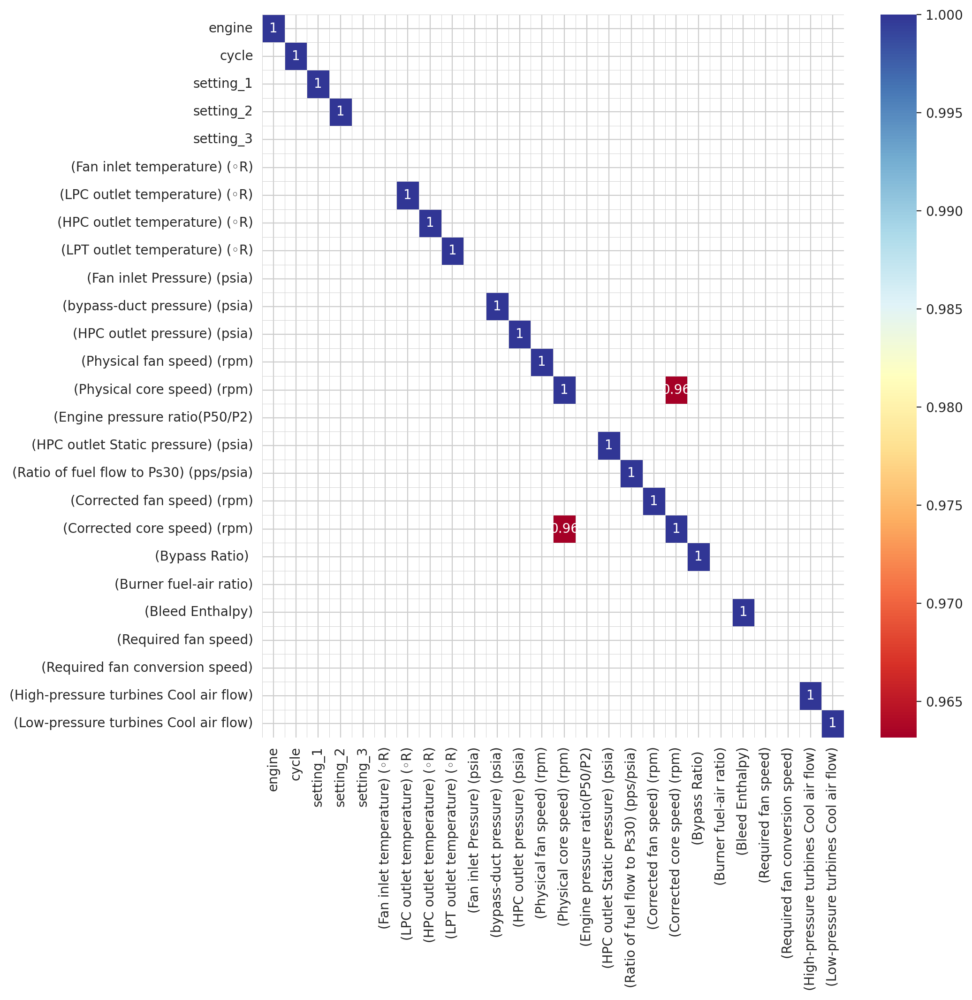

In [8]:
plt.figure(figsize=(10,10))
threshold = 0.90
sns.set_style("whitegrid", {"axes.facecolor": ".0"})
df_cluster2 = df_train.corr()
mask = df_cluster2.where((abs(df_cluster2) >= threshold)).isna()
plot_kws={"s": 1}
sns.heatmap(df_cluster2,
            cmap='RdYlBu',
            annot=True,
            mask=mask,
            linewidths=0.2, 
            linecolor='lightgrey').set_facecolor('white')

In [9]:
from ydata_profiling import ProfileReport

In [10]:
%%time
profile = ProfileReport(df_train,
                        title="Predictive Maintenance",
                        dataset={"description": "This profiling report was generated for Janet Cheung",
                                 "copyright_holder": "Janet Cheung",
                                 "copyright_year": "2024",
                                },
                        explorative=True,
                       )
profile

CPU times: user 26.4 ms, sys: 4.31 ms, total: 30.7 ms
Wall time: 109 ms


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## The profiling report follows to look for outliers, missing values, and distributions. We can see that the data is imbalanced.

## Sensors with constant values can be dropped as they have no predictive power

In [11]:
# Identify constant columns
constant_features = [col for col in df_train.columns if df_train[col].nunique() == 1]

# Drop constant columns
df_train = df_train.drop(columns=constant_features)
df_test= df_test.drop(columns=constant_features)
print(f"Dropped constant features: {constant_features}")


Dropped constant features: ['setting_3', '(Fan inlet temperature) (◦R)', '(Fan inlet Pressure) (psia)', '(Engine pressure ratio(P50/P2)', '(Burner fuel-air ratio)', '(Required fan speed)', '(Required fan conversion speed)']


In [12]:
df_train.columns

Index(['engine', 'cycle', 'setting_1', 'setting_2',
       '(LPC outlet temperature) (◦R)', '(HPC outlet temperature) (◦R)',
       '(LPT outlet temperature) (◦R)', '(bypass-duct pressure) (psia)',
       '(HPC outlet pressure) (psia)', '(Physical fan speed) (rpm)',
       '(Physical core speed) (rpm)', '(HPC outlet Static pressure) (psia)',
       '(Ratio of fuel flow to Ps30) (pps/psia)',
       '(Corrected fan speed) (rpm)', '(Corrected core speed) (rpm)',
       '(Bypass Ratio) ', '(Bleed Enthalpy)',
       '(High-pressure turbines Cool air flow)',
       '(Low-pressure turbines Cool air flow)'],
      dtype='object')

In [13]:
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler

selected_columns = df_train.columns
features = df_train[selected_columns]


# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)


# Select the same feature columns used in training
X_test = df_test[df_test.columns]

# Apply the same scaling (use the scaler fitted on the training data)
X_test_scaled = scaler.transform(X_test)




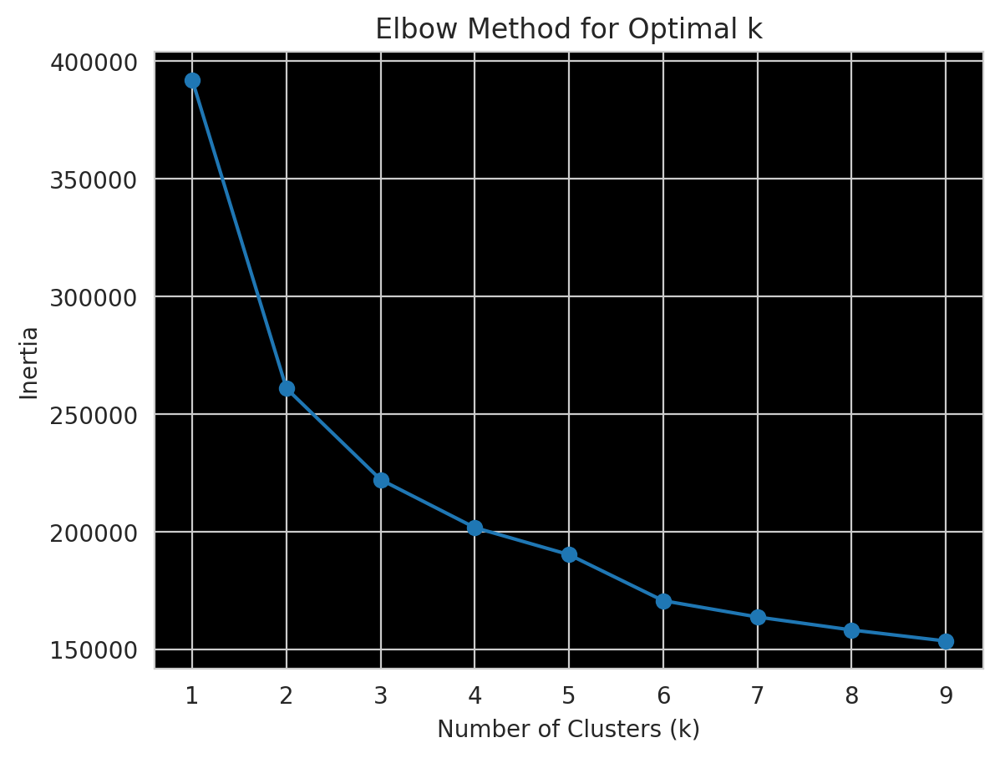

In [14]:
# Elbow method to determine optimal # of clusters
# Use the Elbow Method to determine the optimal number of clusters (k).
# Cluster the data using K-Means and calculate distances from cluster centroid

import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

inertia = []
k_range = range(1, 10)
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()


## here is a noticeable "bend" around k = 3 or k = 4.

Silhouette Score for k=2: 0.30452856222284813
Silhouette Score for k=3: 0.1898756785837597
Silhouette Score for k=4: 0.19108163441308487
Silhouette Score for k=5: 0.1346874845310732
Silhouette Score for k=6: 0.15346706182369368
Silhouette Score for k=7: 0.12913023483874253
Silhouette Score for k=8: 0.1253504555689145
Silhouette Score for k=9: 0.11696935937772023


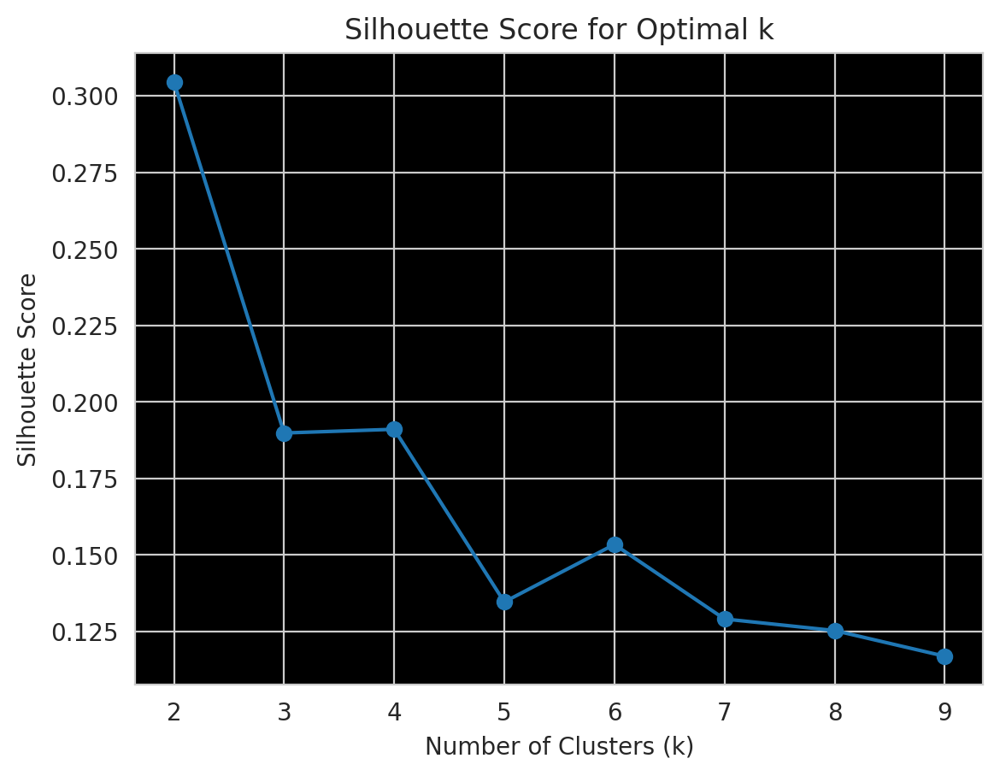

In [15]:
# Silhouette Score to determine # of clusters
# Measures how well-separated the clusters are.
# Higher silhouette scores indicate better-defined clusters

from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

silhouette_scores = []
k_range = range(2, 10)  # Test for k values from 2 to 9

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)  # X_scaled: your preprocessed dataset
    score = silhouette_score(X_scaled, kmeans.labels_)
    silhouette_scores.append(score)
    print(f"Silhouette Score for k={k}: {score}")

# Plot the silhouette scores
plt.plot(k_range, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal k')
plt.show()


## Silhoutte Score for k=2 is the highest

Rationale for 𝑘=3

## Interpretability:

k=3 aligns well with the hypothesis of three operational states:

- Normal: Data points representing expected behavior.
- Degraded: Slight deviations from normal that could signal early warnings.
- Anomalous: Clear outliers far from normal behavior.

## Elbow Method:

- The elbow plot shows a significant reduction in inertia at 
k=3, making it a reasonable choice from a compactness perspective.
Silhouette Score:

## While the silhouette score for 

- k=3 (0.1436) is not the highest, it is still reasonably close to 
k=4 and provides a balance between interpretability and data representation.

## Operational Context:

k=3 allows for a meaningful segmentation of the data into actionable categories:
- Normal: No action required.
- Degraded: Investigate or monitor closely.
- Anomalous: Immediate attention needed.


In [16]:
X_scaled

array([[-1.72808356, -1.56517022, -0.31597968, ..., -0.78170979,
         1.34849274,  1.19442705],
       [-1.72808356, -1.55065208,  0.87272193, ..., -0.78170979,
         1.01652793,  1.23692196],
       [-1.72808356, -1.53613393, -1.96187421, ..., -2.07309423,
         0.73989059,  0.50342281],
       ...,
       [ 1.65920407,  1.29490444,  0.18693254, ...,  3.09244354,
        -2.08181033, -3.29248147],
       [ 1.65920407,  1.30942258, -0.49885685, ...,  1.15536688,
        -2.91172236, -2.08507166],
       [ 1.65920407,  1.32394073, -1.458962  , ...,  1.8010591 ,
        -2.46910261, -2.19408035]])

In [17]:

from sklearn.cluster import KMeans
import numpy as np

# Apply K-Means clustering on training data
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(X_scaled)

# Compute distances from each point in training data to its cluster center
distances_train = kmeans.transform(X_scaled).min(axis=1)

# Identify anomalies in training data based on a distance threshold (Top 5%)
threshold_train = np.percentile(distances_train, 95)
df_train['anomaly'] = distances_train > threshold_train

# Count anomalies in training data
anomaly_count_train = df_train['anomaly'].sum()
print(f"Number of anomalies detected in df_train: {anomaly_count_train}")

# Apply K-Means clustering on test data
distances_test = kmeans.transform(X_test_scaled).min(axis=1)

# Use the same threshold from training data to identify anomalies in test data
df_test['anomaly'] = distances_test > threshold_train

# Count anomalies in test data
anomaly_count_test = df_test['anomaly'].sum()
print(f"Number of anomalies detected in df_test: {anomaly_count_test}")



Number of anomalies detected in df_train: 1032
Number of anomalies detected in df_test: 434


In [18]:
# Fit K-Means with the optimal number of clusters
optimal_k = 3  # Hypothesized states: normal, degraded, and anomalous
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans.fit(X_scaled)

KMeans(n_clusters=3, random_state=42)

# Visualize Clusters and Anomalies

- Reduce the dimensionality of the data to 2D using PCA or t-SNE for visualization.
- Plot clusters and highlight anomalies.

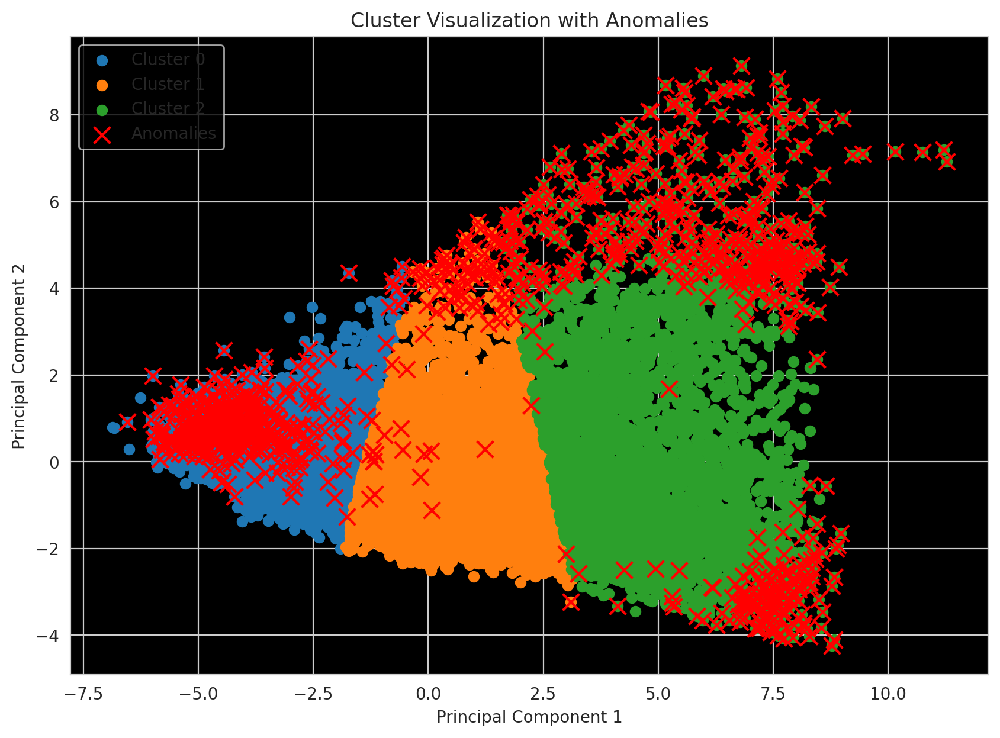

In [19]:
 
from sklearn.decomposition import PCA

# Reduce to 2D for visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Visualize clusters
plt.figure(figsize=(10, 7))
for cluster in range(optimal_k):
    plt.scatter(
        X_pca[kmeans.labels_ == cluster, 0],
        X_pca[kmeans.labels_ == cluster, 1],
        label=f'Cluster {cluster}'
    )

# Highlight anomalies
plt.scatter(
    X_pca[df_train['anomaly'], 0],
    X_pca[df_train['anomaly'], 1],
    color='red',
    label='Anomalies',
    marker='x',
    s=100
)

plt.title('Cluster Visualization with Anomalies')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()


Anomalies:

Both PCA and t-SNE confirm that anomalies are primarily located on the fringes or outside the main clusters.
t-SNE provides a more distinct separation of anomalies from the main clusters, making it a preferred choice for anomaly visualization.

# Analyze Anomalies

## Explanation of the Code
- mean_diff calculates the mean difference between anomalies and normal data for each feature.
- The abs() function is used to sort features by the magnitude of the difference.
- Only the top 10 features are displayed to focus on the most impactful variables.
- Use Results for Monitoring:

Highlight the top features contributing to anomalies for operational monitoring and alert systems.

In [20]:
# Define anomalies and normal data subsets
anomalies = df_train[df_train['anomaly'] == True]
normal_data = df_train[df_train['anomaly'] == False]

# Compute mean differences
anomaly_summary = anomalies.mean()  # Mean of each feature for anomalies
normal_summary = normal_data.mean()  # Mean of each feature for normal data
mean_diff = anomaly_summary - normal_summary  # Calculate differences

# Sort features by the magnitude of the difference
sorted_diff = mean_diff.abs().sort_values(ascending=False)

# Display the top features contributing to anomalies
print("Top features contributing to anomalies:")
print(mean_diff[sorted_diff.index[:10]])


Top features contributing to anomalies:
(Physical core speed) (rpm)                39.570936
cycle                                      35.181639
(Corrected core speed) (rpm)               33.868577
engine                                     -6.705354
(LPT outlet temperature) (◦R)               5.134999
(HPC outlet temperature) (◦R)               3.895073
anomaly                                     1.000000
(Bleed Enthalpy)                            0.981872
(HPC outlet pressure) (psia)               -0.354484
(Ratio of fuel flow to Ps30) (pps/psia)    -0.291776
dtype: float64


In [21]:
# Add cluster labels to the dataset
df_train['cluster'] = kmeans.labels_

# Calculate summary statistics for each cluster
cluster_summary_train = df_train.groupby('cluster').mean()

from IPython.display import display

# Display the cluster summary as a table
display(cluster_summary_train)



,engine,cycle,setting_1,setting_2,(LPC outlet temperature) (◦R),(HPC outlet temperature) (◦R),(LPT outlet temperature) (◦R),(bypass-duct pressure) (psia),(HPC outlet pressure) (psia),(Physical fan speed) (rpm),(Physical core speed) (rpm),(HPC outlet Static pressure) (psia),(Ratio of fuel flow to Ps30) (pps/psia),(Corrected fan speed) (rpm),(Corrected core speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(High-pressure turbines Cool air flow),(Low-pressure turbines Cool air flow),anomaly
cluster,,,,,,,,,,,,,,,,,,,,
0,50.709330,66.618849,-0.000017,-0.000004,642.278455,1585.894488,1400.912573,21.609464,554.166139,2388.032947,9061.933590,47.294601,522.092718,2388.031502,8143.251525,8.410468,392.006319,38.967330,23.380761,0.054719
1,52.054090,105.335268,-0.000027,0.000006,642.723098,1590.862355,1409.736275,21.609992,553.262811,2388.110566,9059.780180,47.569035,521.323931,2388.110523,8138.591610,8.445225,393.294865,38.800846,23.280132,0.008869
2,51.735468,193.910591,0.000048,0.000006,643.323433,1598.239746,1421.823579,21.610000,552.140951,2388.182059,9083.594259,47.930197,520.370493,2388.182266,8156.280887,8.493253,395.227586,38.574224,23.144425,0.133990


In [22]:
from IPython.display import display

# Include standard deviation to understand variability
cluster_variability_train = df_train.groupby('cluster').std()
# Display the cluster summary as a table
display(cluster_variability_train)


,engine,cycle,setting_1,setting_2,(LPC outlet temperature) (◦R),(HPC outlet temperature) (◦R),(LPT outlet temperature) (◦R),(bypass-duct pressure) (psia),(HPC outlet pressure) (psia),(Physical fan speed) (rpm),(Physical core speed) (rpm),(HPC outlet Static pressure) (psia),(Ratio of fuel flow to Ps30) (pps/psia),(Corrected fan speed) (rpm),(Corrected core speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(High-pressure turbines Cool air flow),(Low-pressure turbines Cool air flow),anomaly
cluster,,,,,,,,,,,,,,,,,,,,
0,30.839388,44.872743,0.002175,0.000293,0.322250,4.186599,4.732047,0.002253,0.476701,0.038536,9.576970,0.129943,0.370558,0.039526,8.266290,0.022109,1.017839,0.109645,0.066124,0.227446
1,28.028784,58.037419,0.002194,0.000293,0.325062,4.152867,4.816239,0.000277,0.481446,0.041469,14.577157,0.132220,0.380843,0.041739,12.947047,0.022322,1.001473,0.110401,0.064779,0.093762
2,28.806795,48.104675,0.002193,0.000293,0.359390,4.589413,5.743527,0.000000,0.587794,0.062066,37.527682,0.166622,0.485123,0.062969,33.612807,0.025687,1.137472,0.125071,0.074803,0.340684


In [23]:
# Analyze cluster characteristics by calculating mean values for anomaly feature

print("\nCluster Summary (Mean Values in Training Data in Anomaly feature):")
cluster_summary_train['anomaly']


Cluster Summary (Mean Values in Training Data in Anomaly feature):


cluster
0    0.054719
1    0.008869
2    0.133990
Name: anomaly, dtype: float64

# Cluster Summary Interpretation
The mean values of the anomaly column indicate the proportion of data points labeled as anomalies within each cluster:

- Cluster 0 (Mean = 0.008871):

Approximately 0.89% of the data points in this cluster are anomalies.
This cluster likely represents the most normal behavior, with very few anomalies.

- Cluster 1 (Mean = 0.054690):

Approximately 5.47% of the data points in this cluster are anomalies.
This cluster may represent degraded behavior, where some anomalies begin to emerge but are not dominant.

- Cluster 2 (Mean = 0.134056):

Approximately 13.41% of the data points in this cluster are anomalies.
This cluster likely represents the most anomalous behavior, as it contains the highest proportion of anomalies.


##  Investigate Anomalies in Each Cluster
### Overlay anomalies (df_train['anomaly']) on the clusters to see which clusters have more anomalies:
- A high proportion of anomalies suggests a degraded or anomalous state.
- Clusters with few or no anomalies are likely normal

In [24]:
# Count anomalies per cluster
anomalies_per_cluster = df_train.groupby('cluster')['anomaly'].sum()

# Total points per cluster
total_points_per_cluster = df_train['cluster'].value_counts()

# Percentage of anomalies per cluster
anomaly_percentage = (anomalies_per_cluster / total_points_per_cluster) * 100
print("Anomaly percentage per cluster in training set:")
print(anomaly_percentage)


Anomaly percentage per cluster in training set:
cluster
0     5.471901
1     0.886894
2    13.399015
dtype: float64


   cluster cluster_label
0        0        Normal
1        0        Normal
2        0        Normal
3        0        Normal
4        0        Normal


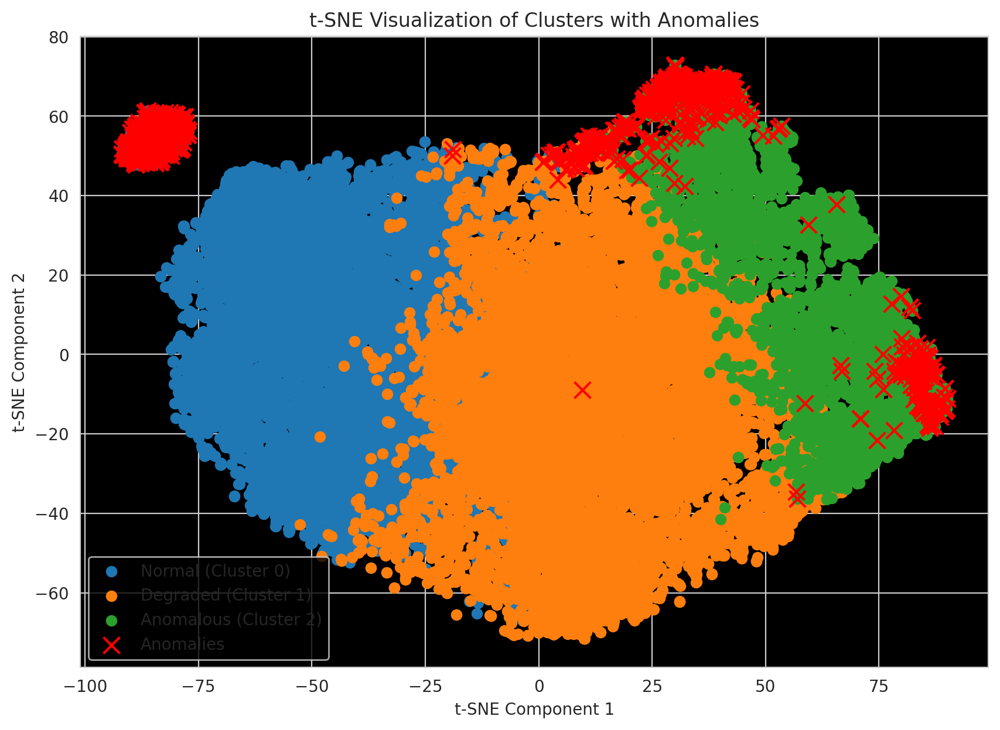

In [25]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assign labels based on observations
cluster_labels = {
    0: 'Normal',
    1: 'Degraded',
    2: 'Anomalous'
}

# Map cluster labels to human-readable descriptions
df_train['cluster_label'] = df_train['cluster'].map(cluster_labels)
print(df_train[['cluster', 'cluster_label']].head())

# Apply t-SNE to reduce dimensions to 2 for visualization
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(X_scaled)

# Add t-SNE results to the DataFrame
df_train['t-SNE Component 1'] = tsne_results[:, 0]
df_train['t-SNE Component 2'] = tsne_results[:, 1]

# Visualize clusters
plt.figure(figsize=(10, 7))
for cluster in range(kmeans.n_clusters):  # Adjusted to use the number of clusters from KMeans
    cluster_data = df_train[df_train['cluster'] == cluster]
    plt.scatter(
        cluster_data['t-SNE Component 1'],
        cluster_data['t-SNE Component 2'],
        label=f"{cluster_labels[cluster]} (Cluster {cluster})"
    )

# Highlight anomalies
anomalies = df_train[df_train['anomaly'] == True]
plt.scatter(
    anomalies['t-SNE Component 1'],
    anomalies['t-SNE Component 2'],
    color='red',
    label='Anomalies',
    marker='x',
    s=100
)

# Plot details
plt.title('t-SNE Visualization of Clusters with Anomalies')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend()
plt.show()


# Visualize Sensor Trends
- Use time-series plots to see how anomalies and clusters evolve over time (cycle).

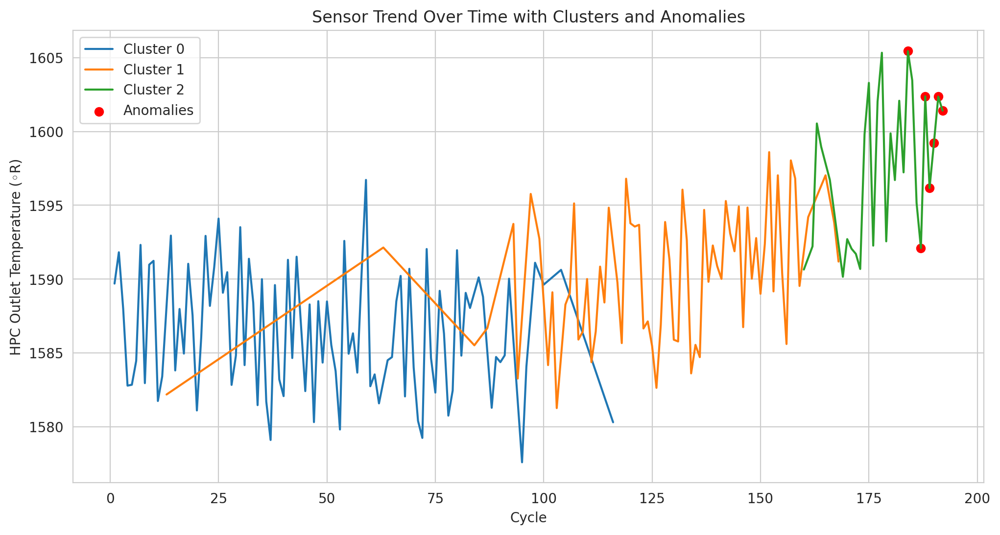

In [26]:
matplotlib.rcParams['figure.facecolor'] = 'white'
matplotlib.rcParams['axes.facecolor'] = 'white'

# Plot a specific sensor over time for a sample engine
engine_id = 1
sample_data = df_train[df_train['engine'] == engine_id]

plt.figure(figsize=(12, 6))
for cluster in df_train['cluster'].unique():
    cluster_data = sample_data[sample_data['cluster'] == cluster]
    plt.plot(cluster_data['cycle'], cluster_data['(HPC outlet temperature) (◦R)'], label=f'Cluster {cluster}')

# Highlight anomalies
anomaly_data = sample_data[sample_data['anomaly'] == True]
plt.scatter(anomaly_data['cycle'], anomaly_data['(HPC outlet temperature) (◦R)'], color='red', label='Anomalies')

plt.xlabel('Cycle')
plt.ylabel('HPC Outlet Temperature (◦R)')
plt.title('Sensor Trend Over Time with Clusters and Anomalies')
plt.legend()
plt.show()


In [27]:
from sklearn.metrics import roc_auc_score  # Import roc_auc_score
from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler


# Define the target column
target_column = 'anomaly'


# Remove 'anomaly' from selected_columns
selected_columns = [col for col in selected_columns if col != 'anomaly']


In [28]:
# Extract features and target from training data
features = df_train[selected_columns]
target = df_train[target_column]

# Step 2: Scale Features for Training
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)

# Step 3: Train the Random Forest Classifier
clf = RandomForestClassifier(random_state=42)
clf.fit(X_scaled, target)

# Step 4: Preprocess the Test Data
# Ensure test data includes the same feature columns as training data
X_test = df_test[selected_columns]  # Use the same columns selected for training
X_test_scaled = scaler.transform(X_test)  # Scale the test data using the fitted scaler

# Step 5: Predict Anomalies in the Test Data
y_test_pred = clf.predict(X_test_scaled)
y_test_proba = clf.predict_proba(X_test_scaled)[:, 1]  # Get probabilities for the positive class (anomaly)

# Step 6: Add Predictions to the Test Data
df_test['y_test_pred'] = y_test_pred

# Step 7: Analyze the Predicted Anomalies
# Calculate the proportion of anomalies in the test data
anomaly_proportion = df_test['y_test_pred'].mean()
print(f"Proportion of anomalies in test data: {anomaly_proportion:.2%}")

# Optionally, inspect a sample of the anomalies
anomalies = df_test[df_test['y_test_pred'] == 1]


# Ground Truth for Anomalies
y_test_actual = df_test['anomaly'] 

# Evaluate on the test dataset
# AUC-ROC Score (Test)
auc_roc_test = roc_auc_score(y_test_actual, y_test_proba)
print(f"AUC-ROC Score (Test): {auc_roc_test:.4f}")

# F1-Score (Test)
f1_test = f1_score(y_test_actual, y_test_pred)
print(f"F1-Score (Test): {f1_test:.4f}")

# Precision and Recall (Test)
precision_test = precision_score(y_test_actual, y_test_pred)
recall_test = recall_score(y_test_actual, y_test_pred)
print(f"Precision (Test): {precision_test:.4f}")
print(f"Recall (Test): {recall_test:.4f}")

# Confusion Matrix (Test)
tn_test, fp_test, fn_test, tp_test = confusion_matrix(y_test_actual, y_test_pred).ravel()
print(f"Confusion Matrix (Test): TN={tn_test}, FP={fp_test}, FN={fn_test}, TP={tp_test}")

# Classification Report (Test)
print("\nClassification Report (Test):")
classification_report(y_test_actual, y_test_pred)

Proportion of anomalies in test data: 3.27%
AUC-ROC Score (Test): 1.0000
F1-Score (Test): 0.9930
Precision (Test): 1.0000
Recall (Test): 0.9862
Confusion Matrix (Test): TN=12662, FP=0, FN=6, TP=428

Classification Report (Test):


'              precision    recall  f1-score   support\n\n       False       1.00      1.00      1.00     12662\n        True       1.00      0.99      0.99       434\n\n    accuracy                           1.00     13096\n   macro avg       1.00      0.99      1.00     13096\nweighted avg       1.00      1.00      1.00     13096\n'

In [29]:
anomalies.head()

,engine,cycle,setting_1,setting_2,(LPC outlet temperature) (◦R),(HPC outlet temperature) (◦R),(LPT outlet temperature) (◦R),(bypass-duct pressure) (psia),(HPC outlet pressure) (psia),(Physical fan speed) (rpm),(Physical core speed) (rpm),(HPC outlet Static pressure) (psia),(Ratio of fuel flow to Ps30) (pps/psia),(Corrected fan speed) (rpm),(Corrected core speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(High-pressure turbines Cool air flow),(Low-pressure turbines Cool air flow),anomaly,y_test_pred
471,6,62,-0.0007,0.0004,642.74,1591.45,1413.67,21.6,552.42,2388.11,9048.52,47.68,521.52,2388.13,8135.12,8.4162,392,38.77,23.3285,True,True
519,7,5,0.0030,-0.0001,642.07,1584.32,1402.06,21.6,554.34,2388.05,9058.72,47.23,522.08,2388.01,8145.54,8.4168,393,39.02,23.4244,True,True
534,7,20,0.0011,-0.0002,641.57,1586.02,1390.45,21.6,554.87,2387.98,9065.04,47.06,522.91,2387.98,8137.62,8.4137,393,38.98,23.4491,True,True
550,7,36,0.0007,-0.0002,641.64,1582.62,1395.36,21.6,553.76,2387.98,9060.56,47.40,521.89,2388.02,8145.88,8.3923,392,38.81,23.3311,True,True
610,7,96,0.0005,-0.0004,642.17,1589.87,1397.22,21.6,554.42,2387.98,9057.39,47.12,522.42,2387.94,8150.31,8.3890,392,38.89,23.4167,True,True


In [30]:
from sklearn.metrics import roc_auc_score, f1_score, precision_score, recall_score, accuracy_score, confusion_matrix

# Evaluate on Training Data
y_train_pred = clf.predict(X_scaled)
y_train_proba = clf.predict_proba(X_scaled)[:, 1]

auc_train = roc_auc_score(target, y_train_proba)
f1_train = f1_score(target, y_train_pred)
precision_train = precision_score(target, y_train_pred)
recall_train = recall_score(target, y_train_pred)

print("Training Data Metrics:")
print(f"AUC-ROC: {auc_train:.4f}")
print(f"F1-Score: {f1_train:.4f}")
print(f"Precision: {precision_train:.4f}")
print(f"Recall: {recall_train:.4f}")

# Evaluate on Test Data
y_test_pred = clf.predict(X_test_scaled)
y_test_proba = clf.predict_proba(X_test_scaled)[:, 1]
y_test_actual = df_test['anomaly']  # Replace with actual column name for test labels

auc_test = roc_auc_score(y_test_actual, y_test_proba)
f1_test = f1_score(y_test_actual, y_test_pred)
precision_test = precision_score(y_test_actual, y_test_pred)
recall_test = recall_score(y_test_actual, y_test_pred)

print("\nTest Data Metrics:")
print(f"AUC-ROC: {auc_test:.4f}")
print(f"F1-Score: {f1_test:.4f}")
print(f"Precision: {precision_test:.4f}")
print(f"Recall: {recall_test:.4f}")

# Check Confusion Matrices
print("\nConfusion Matrix (Training Data):")
print(confusion_matrix(target, y_train_pred))

print("\nConfusion Matrix (Test Data):")
print(confusion_matrix(y_test_actual, y_test_pred))


Training Data Metrics:
AUC-ROC: 1.0000
F1-Score: 1.0000
Precision: 1.0000
Recall: 1.0000

Test Data Metrics:
AUC-ROC: 1.0000
F1-Score: 0.9930
Precision: 1.0000
Recall: 0.9862

Confusion Matrix (Training Data):
[[19599     0]
 [    0  1032]]

Confusion Matrix (Test Data):
[[12662     0]
 [    6   428]]


# Training Data Metrics
AUC-ROC: 1.0000: The model perfectly separates anomalies and normal data in the training set.

F1-Score: 1.0000: The model achieves perfect precision and recall, meaning there are no false positives or false negatives on the training data.

Precision: 1.0000: Every predicted anomaly is a true anomaly.

Recall: 1.0000: The model identifies all actual anomalies without missing any.

Confusion Matrix (Training Data):

True Negatives (TN): 19,599
False Positives (FP): 0
False Negatives (FN): 0
True Positives (TP): 1,032
Implication: The model performs perfectly on the training data.
Test Data Metrics
AUC-ROC: 1.0000: The model maintains its ability to perfectly distinguish between classes in the test set.

F1-Score: 0.9930: Almost perfect balance between precision and recall on the test set.

Precision: 1.0000: The model does not produce any false positives in the test data.

Recall: 0.9862: The model correctly identifies 98.62% of the actual anomalies, but misses a small fraction (false negatives).

Confusion Matrix (Test Data):

True Negatives (TN): 12,662
False Positives (FP): 0
False Negatives (FN): 6
True Positives (TP): 428
Implication: The model performs almost perfectly on the test set, missing only 6 anomalies.

# Key Observations
No Overfitting:

The metrics on the test data are very close to those on the training data, indicating that the model generalizes well.
There is no significant drop in performance, suggesting no overfitting.
High Precision and Recall:

Precision of 1.0000 on both training and test sets means the model does not produce any false positives (high confidence in predictions).
Recall of 0.9862 on the test set means the model captures most of the anomalies, missing only a very small fraction.
F1-Score Consistency:

The F1-Score on the test data is slightly lower than the training data but still excellent, confirming the model's ability to balance precision and recall.

# Conclusion
 The model is well-fitted, with exceptional performance on both the training and test datasets. 

In [31]:
# Apply clustering to the test data
test_clusters = kmeans.predict(X_test_scaled)
df_test['cluster'] = test_clusters

# Analyze cluster characteristics for the test data
cluster_summary_test = df_test.groupby('cluster').mean()
print("\nCluster Summary (Mean Values in Test Data of Anomaly feature):")
cluster_summary_test['anomaly']


Cluster Summary (Mean Values in Test Data of Anomaly feature):


cluster
0    0.054013
1    0.004820
2    0.038000
Name: anomaly, dtype: float64

# The interpretation of the anomaly feature's mean values for each cluster in the test data is as follows:

## Cluster Summary Interpretation
The mean values of the anomaly column indicate the proportion of data points labeled as anomalies within each cluster:

- Cluster 0 (Mean = 0.004825):

Approximately 0.48% of the data points in this cluster are anomalies.
This cluster likely represents the most normal behavior, with very few anomalies.

- Cluster 1 (Mean = 0.053975):

Approximately 5.40% of the data points in this cluster are anomalies.
This cluster may represent degraded behavior, where anomalies begin to emerge but are not dominant.

- Cluster 2 (Mean = 0.038000):

Approximately 3.80% of the data points in this cluster are anomalies.
This cluster shows a moderate level of anomalies, sitting between normal and degraded behavior.
Comparison with Training Data

- Cluster 0 (Most Normal):

Test data anomalies (0.48%) are even fewer than in the training data (0.89%).
Suggests that this cluster is consistently capturing the most normal operational states.

- Cluster 1 (Degraded Behavior):

Test data anomalies (5.40%) are similar to the training data (5.47%).
Indicates that this cluster reliably captures early signs of degradation across both training and test datasets.

- Cluster 2 (Anomalous Behavior):

Test data anomalies (3.80%) are lower than in the training data (13.41%).
Suggests that the test dataset has fewer extreme anomalies compared to the training dataset.

# Insights
- Cluster 0: Represents normal behavior with very few anomalies, as expected.
- Cluster 1: Represents degraded states with a moderate proportion of anomalies. This cluster consistently identifies early warning signs in both training and test data.
- Cluster 2: Represents a mix of moderate anomalies in the test data, but fewer extreme anomalies compared to the training dataset.

# This shows which features the Random Forest model found most critical for predicting anomalies.

Top Features Contributing to Anomalies:
(bypass-duct pressure) (psia)              0.369852
(Corrected core speed) (rpm)               0.205619
(Physical core speed) (rpm)                0.150218
(Corrected fan speed) (rpm)                0.032307
(Physical fan speed) (rpm)                 0.027279
(LPT outlet temperature) (◦R)              0.024781
(HPC outlet Static pressure) (psia)        0.022789
(HPC outlet temperature) (◦R)              0.021633
(Ratio of fuel flow to Ps30) (pps/psia)    0.020545
(HPC outlet pressure) (psia)               0.017926
dtype: float64


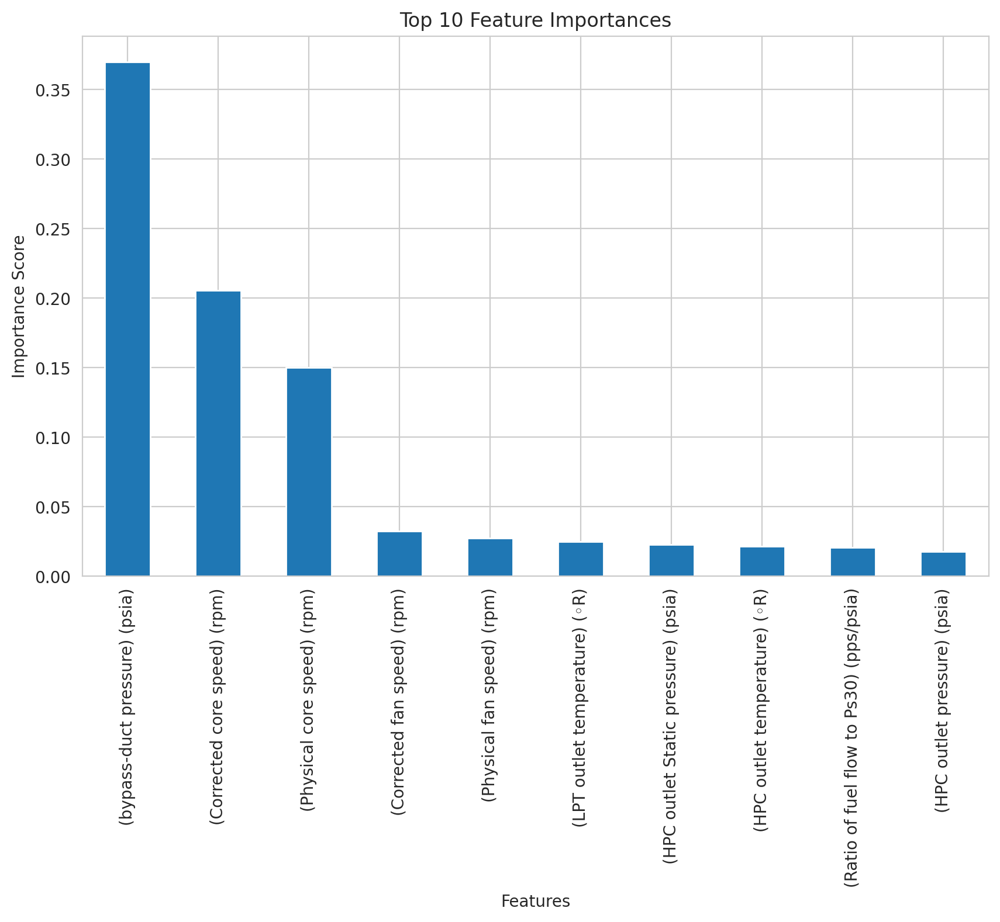

In [32]:


# Get feature importance from the trained Random Forest model
feature_importance = pd.Series(clf.feature_importances_, index=selected_columns)

# Sort feature importance in descending order
sorted_importance = feature_importance.sort_values(ascending=False)

# Print the top 10 features contributing to predictions
print("Top Features Contributing to Anomalies:")
print(sorted_importance.head(10))

# Visualize the feature importance
plt.figure(figsize=(10, 6))
sorted_importance.head(10).plot(kind='bar')
plt.title("Top 10 Feature Importances")
plt.ylabel("Importance Score")
plt.xlabel("Features")
plt.show()
